#### Energy Demand ~ Wind energy generation -  in Ireland

Data-check since 2014 

In [147]:
# Load libraries
import pandas as pd
# import matplotlib.pyplot as plt
import numpy as np
# import scipy.stats as stats
# import seaborn as sns
import plot_creation as plt_data
import preprocessing as pre
import rate_calculation as rc

##### Load data 

In [148]:
# path
PATH = "Path_of_energy_data"
YEARS = [ 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]
month = ['01_Jan', '02_Feb', '03_Mar', '04_Apr', '05_May', '06_Jun', '07_Jul', '08_Aug', '09_Sep', '10_Oct', '11_Nov', '12_Dec']

df = pre.load_data(path = PATH, year= YEARS)


------------------------------------------------------------

Shape of the data:
(1577144, 7)

------------------------------------------------------------
 First 5 rows: 

            DATE & TIME  ACTUAL DEMAND(MW)  FORECAST DEMAND(MW)      REGION  \
0  1 January 2014 00:00               3758                    -  All Island   
1  1 January 2014 00:15               3724                    -  All Island   
2  1 January 2014 00:30               3666                    -  All Island   
3  1 January 2014 00:45               3611                    -  All Island   
4  1 January 2014 01:00               3543                    -  All Island   

    ACTUAL GENERATION(MW)  FORECAST WIND(MW)   ACTUAL WIND(MW)  
0                     NaN                NaN               NaN  
1                     NaN                NaN               NaN  
2                     NaN                NaN               NaN  
3                     NaN                NaN               NaN  
4                     NaN 

##### Preprocess

In [149]:
df_ire, df = pre.data_preprocess(df, typ ='All')


------------------------------------------------------------
 Column Names:
Index([' REGION', 'DATE & TIME', ' ACTUAL DEMAND(MW)', ' FORECAST DEMAND(MW)',
       ' ACTUAL GENERATION(MW)', ' FORECAST WIND(MW)', '  ACTUAL WIND(MW)'],
      dtype='object')

------------------------------------------------------------

 Dataset information:
--------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
Int64Index: 525696 entries, 0 to 525695
Data columns (total 9 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0    REGION                 525696 non-null  object        
 1   DATE & TIME             525696 non-null  object        
 2    ACTUAL DEMAND(MW)      525530 non-null  object        
 3    FORECAST DEMAND(MW)    0 non-null       float64       
 4    ACTUAL GENERATION(MW)  522541 non-null  float64       
 5    FORECAST WIND(MW)      478122 non-null  object        

In [150]:
# Constants
DEMAND = 'Demand'
GENERATION = 'Generation'
WIND_G = 'Wind_G'
WIND_F = 'Wind_F'

#### Yearly data (Demand ~ Wind generation) - Ireland

##### Compare avg yearly demand ~ avg. wing generation

In [151]:
# avg. demand per year
avg_yearly_demand_ire = df_ire.groupby(df_ire.index.year).agg({DEMAND: 'mean'})
# avg. wind per year
avg_yearly_wind_ire = df_ire.groupby(df_ire.index.year).agg({ WIND_G: 'mean'})

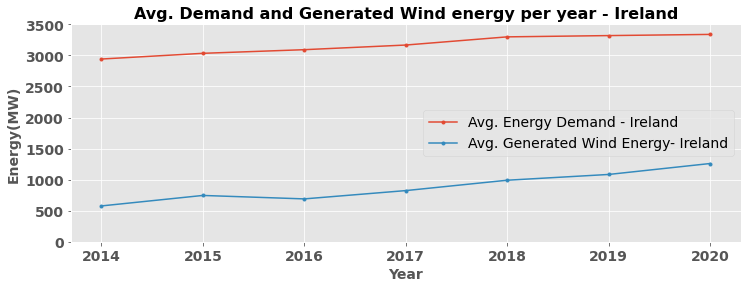

In [6]:
# Ireland's avg. actual demand and avg. wind power generation per year
plt_data.plot_yearly_data(  demand = avg_yearly_demand_ire[:7],
                            wind = avg_yearly_wind_ire[:7], 
                            figsize=(12,4),
                            label_demand ='Avg. Energy Demand - Ireland', 
                            label_wind ='Avg. Generated Wind Energy- Ireland', 
                            title = "Avg. Demand and Generated Wind energy per year - Ireland", 
                            ylim = (0,3500) )

##### Compare Ireland's yearly - demand(total) ~ wind(total) 

In [152]:
# total demand per year
tot_yearly_demand_ire = df_ire.groupby(df_ire.index.year)[DEMAND].sum()
# total wind per year
tot_yearly_wind_ire = df_ire.groupby(df_ire.index.year)[WIND_G].sum()

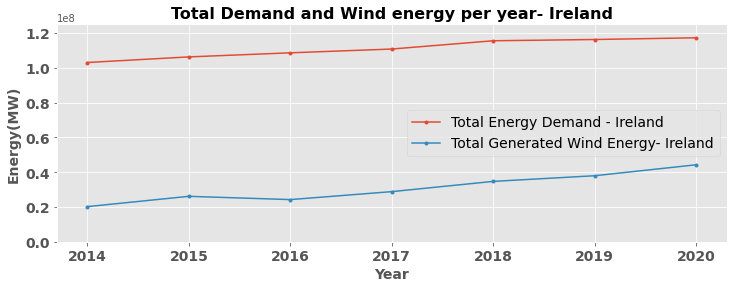

In [9]:
# Ireland's avg. actual demand and avg. wind power generation per year
plt_data.plot_yearly_data(  demand = tot_yearly_demand_ire[:7],
                            wind = tot_yearly_wind_ire[:7], 
                            figsize=(12,4),
                            label_demand ='Total Energy Demand - Ireland', 
                            label_wind ='Total Generated Wind Energy- Ireland', 
                            title = "Total Demand and Wind energy per year- Ireland", 
                            ylim = (0, 1.25*10**8) )

#### Yearly growth rate 

In [153]:
# bar chart 
BAR_LABELS_Y = [ 2015, 2016, 2017, 2018, 2019, 2020 ]
BASE_YEAR = 2014
BARWIDTH = 0.3

##### Yearly Growth rate Actual demand(IRELAND)

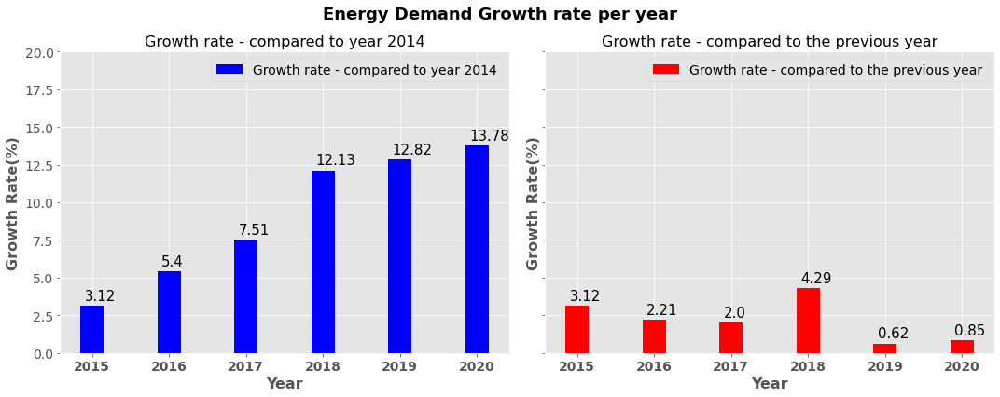

In [11]:
# Yearly growth rate of Energy Demand - compared to 2014
# Yearly growth rate of Energy Demand - compared to the previous year
gr_values1, gr_values2 = rc.compute_yearly_growth_rates(df=tot_yearly_demand_ire[:7], years_selected = BAR_LABELS_Y, base_year=BASE_YEAR)

# Energy Deamnd growth rate
plt_data.plot_yearly_growth_rate(   bar_values1 =  gr_values1,
                                    base_year = BASE_YEAR,
                                    bar_values2 = gr_values2,
                                    suptitle = "Energy Demand Growth rate per year", 
                                    xticklabels = BAR_LABELS_Y , 
                                    barwidth = BARWIDTH ,
                                    ha='left',
                                    # rot=45,
                                    ylim = (0,20),
                                    figsize = (15,6) )

##### Yearly Growth rate Wind Generation(Ireland)

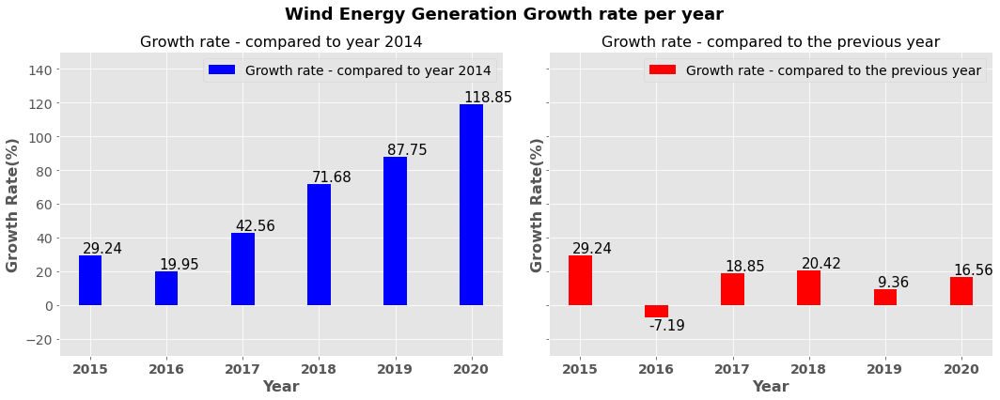

In [20]:
# Yearly growth rate of Wind Energy Generation - compared to 2014
# Yearly growth rate of Wind Energy Generation - compared to the previous year
gr_y_wind1, gr_y_wind2 = rc.compute_yearly_growth_rates(tot_yearly_wind_ire[:7], years_selected = BAR_LABELS_Y, base_year=2014)

# Wind Energy Generation growth rate
plt_data.plot_yearly_growth_rate(   bar_values1 =  gr_y_wind1,
                                    base_year = BASE_YEAR,
                                    bar_values2 = gr_y_wind2,
                                    suptitle = "Wind Energy Generation Growth rate per year", 
                                    xticklabels = BAR_LABELS_Y , 
                                    barwidth = BARWIDTH,
                                    ha='left',
                                    # rot=45,
                                    ylim = (-30,150),
                                    figsize = (15,6)    )

#### Statistical Analysis

In [154]:
from scipy.stats import kruskal, mannwhitneyu

def compare_2_samples(data1, data2, alpha= 0.05, dist='Norm'):
    # compare samples
    # for non-normal distribution  - Mann-Whitney U Test
    print("Mann-Whitney U Test") 
    stat, p = mannwhitneyu(data1, data2)
        
    print('Statistics=%.3f, p-value=%s' % (stat, p))

    # interpret
    if p > alpha:
	    print('Same distribution (fail to reject H0)')
    else:
	    print('Different distribution (reject H0)')

In [155]:
# year wise actual demand
demand_ire_2014 = df_ire.loc[df_ire['year'] == 2014]['Demand'] 
demand_ire_2015 = df_ire.loc[df_ire['year'] == 2015]['Demand']
demand_ire_2016 = df_ire.loc[df_ire['year'] == 2016]['Demand']
demand_ire_2017 = df_ire.loc[df_ire['year'] == 2017]['Demand']
demand_ire_2018 = df_ire.loc[df_ire['year'] == 2018]['Demand']
demand_ire_2019 = df_ire.loc[df_ire['year'] == 2019]['Demand']
demand_ire_2020 = df_ire.loc[df_ire['year'] == 2020]['Demand']
demand_ire_2021 = df_ire.loc[df_ire['year'] == 2021]['Demand']

demand_years = { 
    2014 : demand_ire_2014.dropna(), 
    2015 : demand_ire_2015.dropna(), 
    2016 : demand_ire_2016.dropna(), 
    2017 : demand_ire_2017.dropna(), 
    2018 : demand_ire_2018.dropna(), 
    2019 : demand_ire_2019.dropna(), 
    2020 : demand_ire_2020.dropna() 
            }

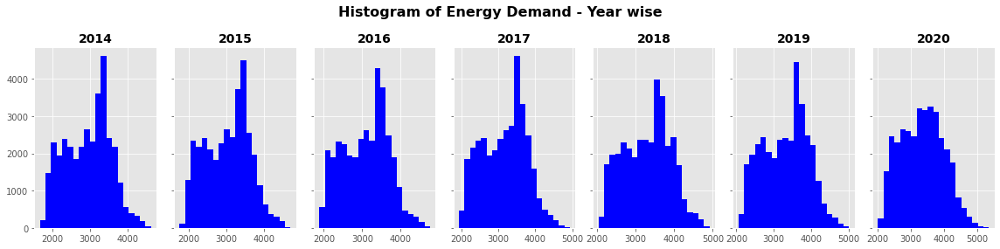

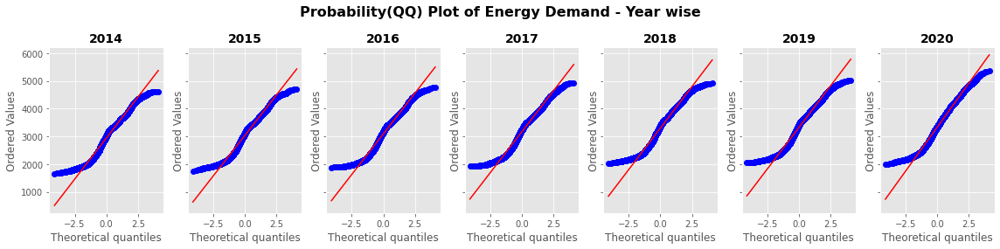

In [171]:
# Plot Histogram of yearly demand
plt_data.plot_normality_check(   
    data = demand_years,  
    figsize = (16,4),
    title = "Histogram of Energy Demand - Year wise", 
    plot_type='H'  # histogram
)

# QQ-plot of yearly demand
plt_data.plot_normality_check(   
    data = demand_years,  
    figsize = (16,4),
    title = "Probability(QQ) Plot of Energy Demand - Year wise", 
    # ylim = (1000,5600),
    plot_type='Q' # QQ plot
)


In [156]:
print('Comparison of energy demand - yearly data')
print('---------------------------------------------------------')
print( '\nYears in comparison : 2014, 2015, 2016, 2017, 2018, 2019, 2020')

print("Kruskal-Wallis H Test") 
stat, p = kruskal(
    demand_ire_2014.dropna(), 
    demand_ire_2015.dropna(), 
    demand_ire_2016.dropna(), 
    demand_ire_2017.dropna(), 
    demand_ire_2018.dropna(), 
    demand_ire_2019.dropna(), 
    demand_ire_2020.dropna()
)
print('Statistics=%.3f, p-value=%s' % (stat, p))

# interpret
alpha =0.05
if p > alpha:
	print('Same distribution (fail to reject H0)')
else:
	print('Different distribution (reject H0)')

Comparison of energy demand - yearly data
---------------------------------------------------------

Years in comparison : 2014, 2015, 2016, 2017, 2018, 2019, 2020
Kruskal-Wallis H Test
Statistics=12122.047, p-value=0.0
Different distribution (reject H0)


In [157]:
# pair wise comparision
for k , v in  demand_years.items():

    if k == 2020:
        continue

    print("\nComparison between years %s and %s" %(k, 2020))
    compare_2_samples( 
        v.dropna(),
        demand_ire_2020.dropna(), 
        alpha= 0.05, 
        dist='Non-Norm'
    )


Comparison between years 2014 and 2020
Mann-Whitney U Test
Statistics=411462293.000, p-value=0.0
Different distribution (reject H0)

Comparison between years 2015 and 2020
Mann-Whitney U Test
Statistics=456271300.000, p-value=0.0
Different distribution (reject H0)

Comparison between years 2016 and 2020
Mann-Whitney U Test
Statistics=488706461.500, p-value=0.0
Different distribution (reject H0)

Comparison between years 2017 and 2020
Mann-Whitney U Test
Statistics=526322143.000, p-value=3.0904199382038543e-238
Different distribution (reject H0)

Comparison between years 2018 and 2020
Mann-Whitney U Test
Statistics=598136256.000, p-value=6.055665517345507e-11
Different distribution (reject H0)

Comparison between years 2019 and 2020
Mann-Whitney U Test
Statistics=610008530.500, p-value=0.02208700573265482
Different distribution (reject H0)


#### Monthly data (Demand ~ Wind generation) - Ireland

In [158]:
ire = df[df[' REGION']== 'Ireland'][[DEMAND, GENERATION, 'datetime', WIND_G, WIND_F]]

In [159]:
X_LABELS = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

##### Avg. monthly demand - yearwise

In [10]:
#lockdown stages
STAGE1 = 'Start of lockdown'
STAGE2 = 'Phase 1 reopning'
STAGE3 = 'Phase 2 reopning'
STAGE4 = 'Phase 3 reopning'
STAGE5 = 'Phase 4 reopning'
STAGE6 = 'Phase 5 reopning'
STAGE7 = '2nd Lockdown'
STAGE8 = 'Reopning'
STAGE9 = '3rd Lockdown'

# Stages of lockdown weeks
LOCKDOWN_STAGES_M = {   STAGE1 : 2.86, # Start of lockdown
                        STAGE2 : 4.57, # Phase 1 reopning
                        STAGE3 : 5.26, # Phase 2 reopning
                        STAGE4 : 5.95, # Phase 3 reopning
                        STAGE5 : 6.64, # Phase 4 reopning
                        STAGE6 : 7.33, # Phase 5 reopning
                        STAGE7 : 9.70, # 2nd Lockdown
                        STAGE8 : 11.05, # Reopning
                        STAGE9 : 11.87  # 3rd Lockdown
                        }

In [28]:
# resample avg for month 
avg_ire_1M = ire.set_index('datetime').resample('1M').mean()

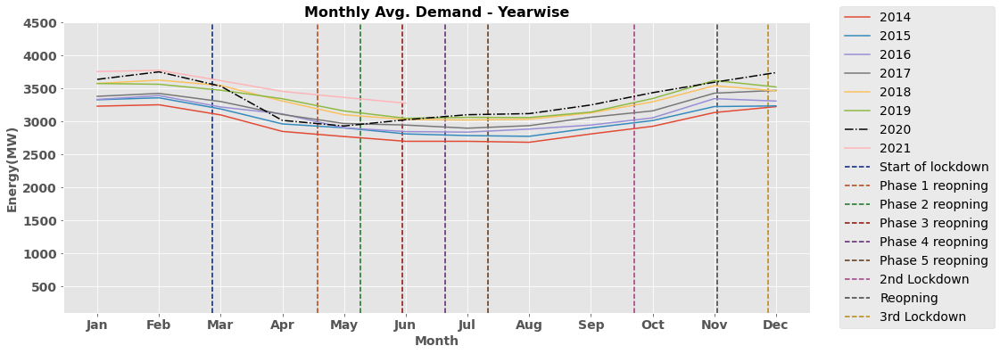

In [29]:
# Ireland's avg. demand per month each year
plt_data.create_line_plot(  df=avg_ire_1M,
                            selected_years= YEARS,
                            v_loc=LOCKDOWN_STAGES_M,
                            typ = DEMAND,
                            title='Monthly Avg. Demand - Yearwise',
                            ylabel='Energy(MW)',
                            xlabel='Month', 
                            xticks=range(1, 13),
                            xticklabels = X_LABELS,  
                            figsize=(15,6), 
                            ylim = (100,4500)
                            )

##### Avg. monthly wind energy generation - yearwise

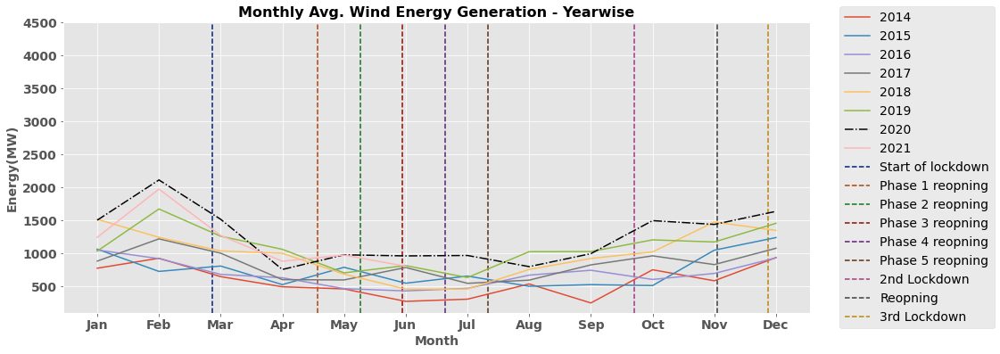

In [30]:
plt_data.create_line_plot(  df=avg_ire_1M,
                            selected_years= YEARS,
                            title='Monthly Avg. Wind Energy Generation - Yearwise',
                            v_loc=LOCKDOWN_STAGES_M,
                            typ = WIND_G,
                            ylabel='Energy(MW)',
                            xlabel='Month', 
                            xticks=range(1, 13),
                            xticklabels = X_LABELS,  
                            figsize=(15,6),
                            ylim = (100,4500)
                            )

##### Total montly demand every year

In [45]:
# resample total for month 
tot_ire_1M = ire.set_index('datetime').resample('1M').sum()

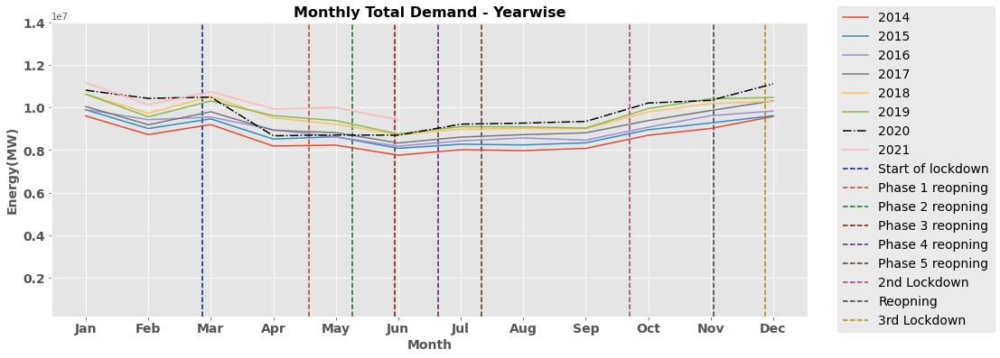

In [35]:
# Ireland's total demand per month each year
plt_data.create_line_plot(  df = tot_ire_1M,
                            selected_years= YEARS,
                            title='Monthly Total Demand - Yearwise',
                            v_loc=LOCKDOWN_STAGES_M,
                            typ = DEMAND,
                            ylabel='Energy(MW)',
                            xlabel='Month', 
                            xticks=range(1, 13),
                            xticklabels = X_LABELS,  
                            figsize=(15,6),
                            ylim = (0.2*10**6, 1.4*10**7)
                            )

##### Total montly Wind energy generation every year

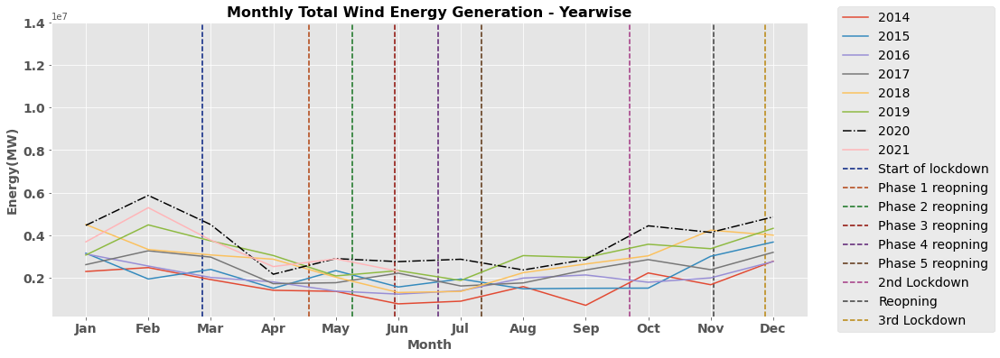

In [36]:
# Ireland's total demand per month each year
plt_data.create_line_plot(  df = tot_ire_1M,
                            selected_years= YEARS,
                            title='Monthly Total Wind Energy Generation - Yearwise',
                            v_loc=LOCKDOWN_STAGES_M,
                            typ = WIND_G,
                            ylabel='Energy(MW)',
                            xlabel='Month', 
                            xticks=range(1, 13),
                            xticklabels = X_LABELS,  
                            figsize=(15,6), 
                            ylim = (0.2*10**6, 1.4*10**7)
                            )

##### Energy Demand Growth rate - month wise

In [76]:
X_LABELS = ['Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug']

com1_tot_ire_1M = pd.DataFrame()
com2_tot_ire_1M = pd.DataFrame()
for m in np.arange(1,9):
    df_m = tot_ire_1M[tot_ire_1M.index.month == m]
    com1_tot_ire_1M = com1_tot_ire_1M.append(df_m)

    if m != 1:
        com2_tot_ire_1M = com2_tot_ire_1M.append(df_m)


tot_monthly_data_ire = rc.format_data_yearwise(df=com1_tot_ire_1M)
tot_monthly_data_ire_hat = rc.format_data_yearwise(df=com2_tot_ire_1M)

In [77]:
# monthly growth rate of the years 2018, 2019, 2020, 2021 compared to 2017
gr_monthly_demand = rc.calculate_growth_rates_with_base_year(   base_year = 2017,
                                                                years_to_compare = [2018,2019,2020, 2021],
                                                                data = tot_monthly_data_ire_hat,
                                                                typ = DEMAND
                                                                )

# monthly groth rate of 2020 compared to the previous month - Energy Demand
gr_mon_demand_2020 = rc.calculate_growth_rates_with_prev(year = 2020, data = tot_monthly_data_ire, typ= DEMAND ) #, last_check = False

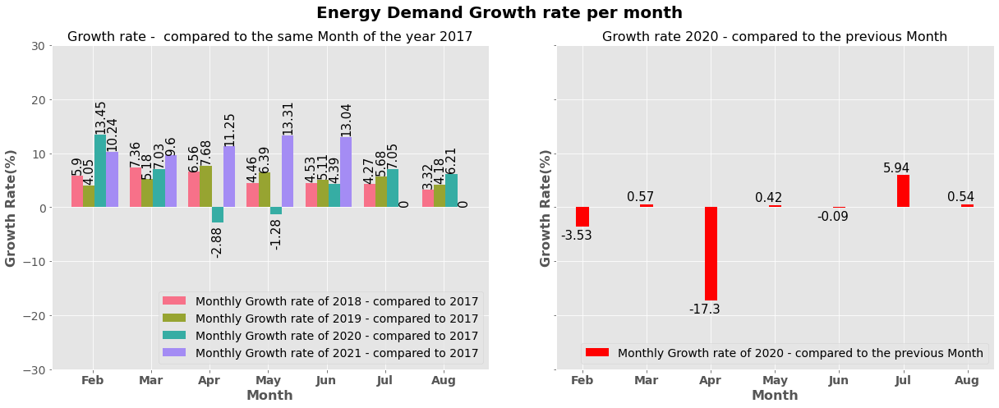

In [124]:
# Energy Demand growth rate - monthly 
plt_data.plot_growth_rates( gr1 = gr_monthly_demand,  # Growth rate compared to - 2017
                            years_to_compare = [2018,2019,2020, 2021],
                            base_year = 2017, 
                            gr2 = gr_mon_demand_2020[1:8],  # Growth rate compared to the previous month for 2020
                            gr2_y=2020,
                            typ = 'Month',
                            barwidth = 0.2, 
                            title= "Energy Demand Growth rate per month",
                            ha='left',
                            rot=90,
                            xtick_labels=X_LABELS,
                            figsize=(17,7),
                            ylim=(-30,30),
                            legend_loc='lower right' ) 

##### Statistical analysis

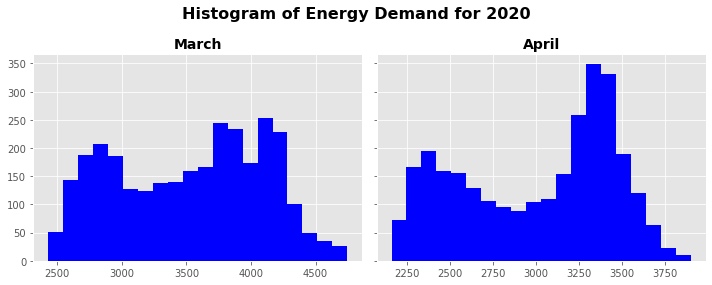

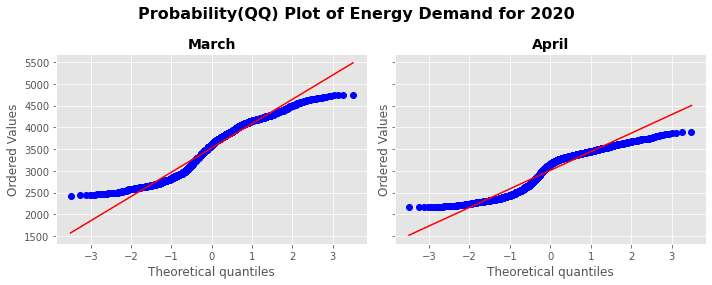

Sample size -March -2020 : 2972
Sample size -April -2020 : 2880
Mann-Whitney U Test
Statistics=2136593.000, p-value=1.5531669424729458e-241
Different distribution (reject H0)


In [170]:
demand_2020 = df_ire[df_ire.year == 2020][DEMAND]
demand_mar_2020 = demand_2020[demand_2020.index.month == 3]
demand_apr_2020 = demand_2020[demand_2020.index.month == 4]

demand1 = {
    'March': demand_mar_2020.dropna(),
    'April': demand_apr_2020.dropna()
}

# ~------------------------------Normality assumtion----------------------
# Plot Histogram of yearly demand
plt_data.plot_normality_check(  data = demand1,  
                                figsize = (10,4) ,
                                title = "Histogram of Energy Demand for 2020", 
                                # ylim = (0,300),
                                plot_type='H'  # histogram
                            )

# QQ-plot of yearly demand
plt_data.plot_normality_check(  data = demand1, 
                                figsize = (10,4) , 
                                title = "Probability(QQ) Plot of Energy Demand for 2020", 
                                # ylim = (1000,5600),
                                plot_type='Q' # QQ plot
                            )

print('Sample size -March -2020 : %s'  %(len(demand_mar_2020.dropna())))
print('Sample size -April -2020 : %s'  %(len(demand_apr_2020.dropna())))    


compare_2_samples(
    data1= demand_mar_2020.dropna(), 
    data2= demand_apr_2020.dropna(), 
    alpha= 0.05, 
    dist = 'Non-Normal'
)

In [161]:
demand_2017 = df_ire[df_ire.year == 2017][DEMAND]
demand_2018 = df_ire[df_ire.year == 2018][DEMAND]
demand_2019 = df_ire[df_ire.year == 2019][DEMAND]
demand_2021 = df_ire[df_ire.year == 2021][DEMAND]

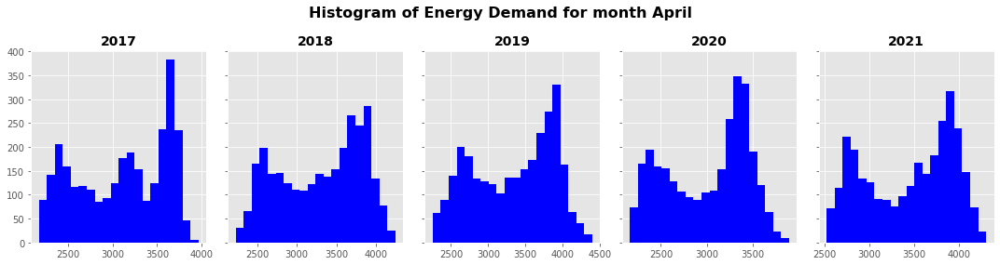

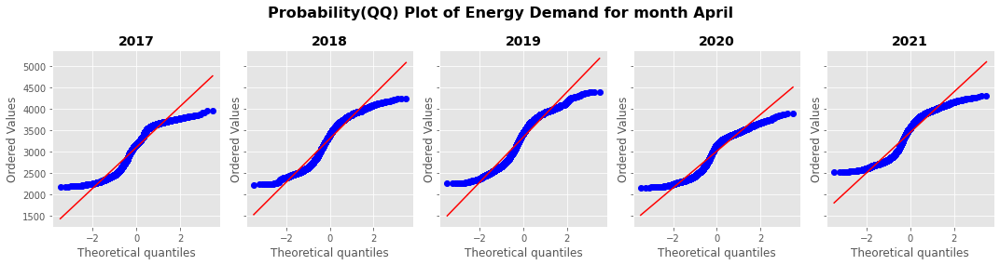

Sample size -April -2017 : 2880
Sample size -April -2018 : 2880
Sample size -April -2019 : 2880
Sample size -April -2020 : 2880
Sample size -April -2021 : 2880


In [173]:
demand_apr_2017 = demand_2017[demand_2017.index.month == 4]
demand_apr_2018 = demand_2018[demand_2018.index.month == 4]
demand_apr_2019 = demand_2019[demand_2019.index.month == 4]
demand_apr_2021 = demand_2021[demand_2021.index.month == 4]

demand2 = {
    2017 : demand_apr_2017.dropna(),
    2018 : demand_apr_2018.dropna(),
    2019 : demand_apr_2019.dropna(),
    2020 : demand_apr_2020.dropna(),
    2021 : demand_apr_2021.dropna()
}

# ~------------------------------Normality assumtion----------------------
# Plot Histogram of yearly demand
plt_data.plot_normality_check(  data = demand2,
                                figsize = (15,4) ,  
                                title = "Histogram of Energy Demand for month April", 
                                # ylim = (0,300),
                                plot_type='H'  # histogram
                            )

# QQ-plot of yearly demand
plt_data.plot_normality_check(  data = demand2,
                                figsize = (15,4) ,  
                                title = "Probability(QQ) Plot of Energy Demand for month April", 
                                # ylim = (1000,5600),
                                plot_type='Q' # QQ plot
                            )

print('Sample size -April -2017 : %s'  %(len(demand_apr_2017.dropna()))) 
print('Sample size -April -2018 : %s'  %(len(demand_apr_2018.dropna()))) 
print('Sample size -April -2019 : %s'  %(len(demand_apr_2019.dropna()))) 
print('Sample size -April -2020 : %s'  %(len(demand_apr_2020.dropna()))) 
print('Sample size -April -2021 : %s'  %(len(demand_apr_2021.dropna())))  


In [163]:
print('Comaparison of energy demand for the month of April')
print('---------------------------------------------------------')
print( '\nYears in comparison : 2017, 2018,2019,2020,2021')
print("Kruskal-Wallis H Test") 
stat, p = kruskal(
    demand_apr_2017.dropna(), 
    demand_apr_2018.dropna(), 
    demand_apr_2019.dropna(), 
    demand_apr_2020.dropna(), 
    demand_apr_2021.dropna()
)
print('Statistics=%.3f, p-value=%s' % (stat, p))

# interpret
alpha =0.05
if p > alpha:
	print('Same distribution (fail to reject H0)')
else:
	print('Different distribution (reject H0)')


for k , v in  demand2.items():

    if k == 2020:
        continue

    print("\nComparison between years %s and %s" %(k, 2020))
    compare_2_samples( 
        v.dropna(),
        demand_apr_2020.dropna(), 
        alpha= 0.05, 
        dist='Non-Norm'
    )

Comaparison of energy demand for the month of April
---------------------------------------------------------

Years in comparison : 2017, 2018,2019,2020,2021
Kruskal-Wallis H Test
Statistics=1463.869, p-value=0.0
Different distribution (reject H0)

Comparison between years 2017 and 2020
Mann-Whitney U Test
Statistics=3613706.500, p-value=1.4037280992088218e-17
Different distribution (reject H0)

Comparison between years 2018 and 2020
Mann-Whitney U Test
Statistics=2713660.000, p-value=1.5069907445192082e-114
Different distribution (reject H0)

Comparison between years 2019 and 2020
Mann-Whitney U Test
Statistics=2615080.500, p-value=1.6094500960816419e-130
Different distribution (reject H0)

Comparison between years 2021 and 2020
Mann-Whitney U Test
Statistics=2131940.000, p-value=4.2285416201985634e-224
Different distribution (reject H0)


##### wind energy generation Growth rate - month wise

In [164]:
# monthly growth rate of the years 2018, 2019, 2020, 2021 compared to 2017
gr_monthly_wind = rc.calculate_growth_rates_with_base_year( base_year = 2017,
                                                            years_to_compare = [2018,2019,2020, 2021],
                                                            data = tot_monthly_data_ire_hat,
                                                            typ = WIND_G    )

# monthly groth rate of 2020 compared to the previous month - wind generation
gr_mon_wind_2020 = rc.calculate_growth_rates_with_prev(year = 2020, data = tot_monthly_data_ire, typ= WIND_G )

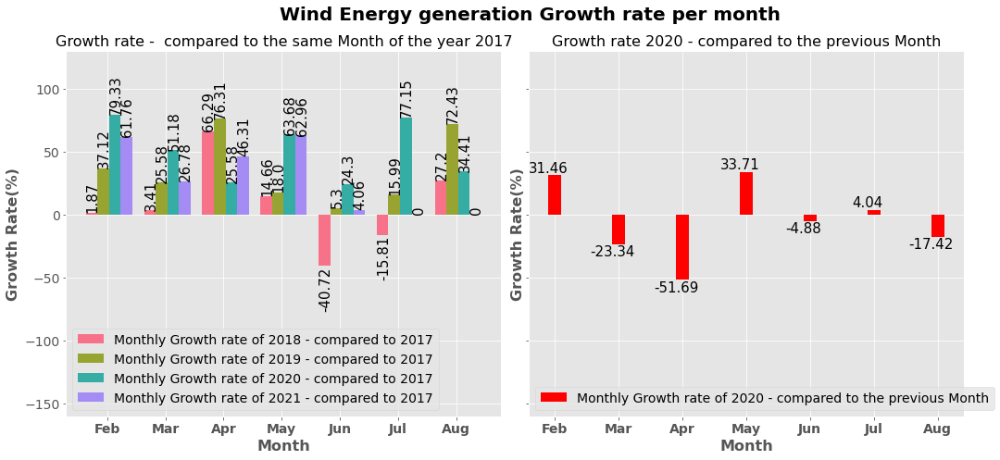

In [122]:
# Wind energy generation growth rate -Monthly
plt_data.plot_growth_rates( gr1 = gr_monthly_wind,  # Growth rate compared to - 2017
                            years_to_compare = [2018,2019,2020, 2021],
                            base_year = 2017,
                            gr2 = gr_mon_wind_2020[1:8],  # Growth rate compared to the previous month for 2020
                            gr2_y=2020 ,
                            typ = 'Month',
                            barwidth = 0.2,
                            title= "Wind Energy generation Growth rate per month",
                            ha='left',           
                            rot=90,
                            xtick_labels = X_LABELS,
                            figsize=(16, 7),
                            ylim =(-160,130),
                            legend_loc='lower left' ) 

#### Weekly Data - Ireland

In [11]:
# Stages of lockdown weeks
LOCKDOWN_STAGES_W = {   STAGE1 : 12.43, # Start of lockdown
                        STAGE2 : 19.86, # Phase 1 reopning
                        STAGE3 : 22.86, # Phase 2 reopning
                        STAGE4 : 25.86, # Phase 3 reopning
                        STAGE5 : 28.86, # Phase 4 reopning
                        STAGE6 : 31.86, # Phase 5 reopning
                        STAGE7 : 41.14, # 2nd Lockdown
                        STAGE8 : 48.00, # Reopning
                        STAGE9 : 51.57  # 3rd Lockdown
                        }

In [12]:
# resample avg for 1 week 
avg_ire_1w = ire.set_index('datetime').resample('1W').mean()

##### Weekly moving-Avg. demand - year wise

In [16]:
# step 1:- resample avg for 1week 
# step 2:- each week moving  avg
ra_ire_1w = ire.set_index('datetime').resample('1W').mean().rolling(window=4).mean()

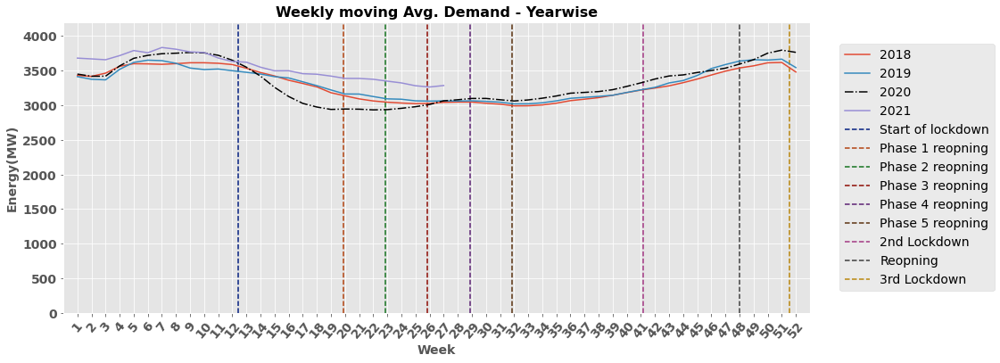

In [127]:
# weekly moving avarage  demand plot - year wise
plt_data.create_line_plot(  df=ra_ire_1w,
                            selected_years=[2018, 2019, 2020, 2021],
                            title='Weekly moving Avg. Demand - Yearwise',
                            v_loc=LOCKDOWN_STAGES_W,
                            typ=DEMAND,  # Demand data
                            ylabel='Energy(MW)',
                            xlabel='Week',
                            xticks=range(1, 53), 
                            figsize=(15,6),
                            xlim=(0,53), 
                            ylim=(0,4200),
                            xtick_rot=50
                         )

##### Weekly moving-Avg. Wind energy generation - year wise

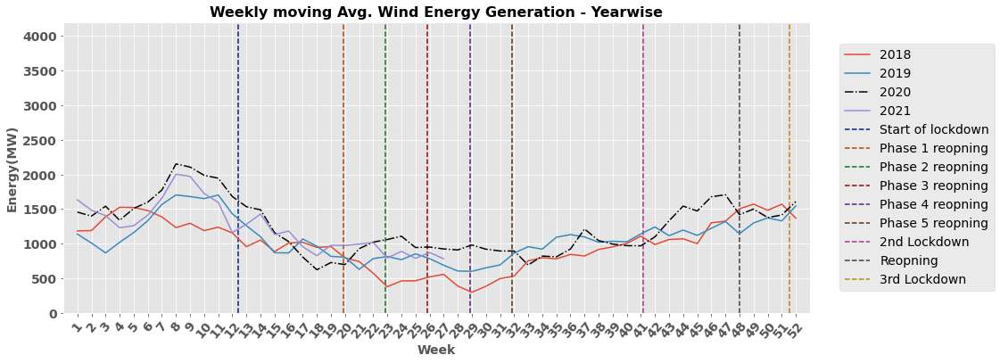

In [128]:
# weekly moving-avg. Wind energy generation plot - year wise
plt_data.create_line_plot(  df=ra_ire_1w,
                            selected_years=[2018, 2019, 2020, 2021],    
                            title='Weekly moving Avg. Wind Energy Generation - Yearwise',
                            v_loc=LOCKDOWN_STAGES_W,
                            typ=WIND_G, # Wind generation data
                            xlabel='Week',
                            ylabel='Energy(MW)',
                            xticks=range(1, 53), 
                            figsize=(15,6),
                            xlim=(0,53), 
                            ylim=(0,4200),
                            xtick_rot = 50
                            )

##### Weekly Growth rate 

In [79]:
x_week = np.arange(10,34)
com1_avg_ire_1w = pd.DataFrame()
com2_avg_ire_1w = pd.DataFrame()
for w in x_week :
    df_t = avg_ire_1w[avg_ire_1w.index.isocalendar().week == w]
    com1_avg_ire_1w = com1_avg_ire_1w.append(other=df_t)

    if w != x_week[0] :
        com2_avg_ire_1w = com2_avg_ire_1w.append(other=df_t)


avg_ire_w = rc.format_data_yearwise( df=com1_avg_ire_1w)
avg_ire_w_hat = rc.format_data_yearwise( df=com2_avg_ire_1w)

##### Energy Demand growth rate - weekly

In [94]:
# weekly Growth rate of demand in 2020- compared to previous week
gr_w_2020_demand = rc.calculate_growth_rates_with_prev(year=2020, data=avg_ire_w, typ=DEMAND)

# weekly growth rate the years 2019, 2020, 2021 compared to 2018
gr_weekly_demand = rc.calculate_growth_rates_with_base_year(    base_year=2018,
                                                                years_to_compare=[2019, 2020, 2021],
                                                                data = avg_ire_w_hat,
                                                                typ=DEMAND   # Demand data
                                                                )

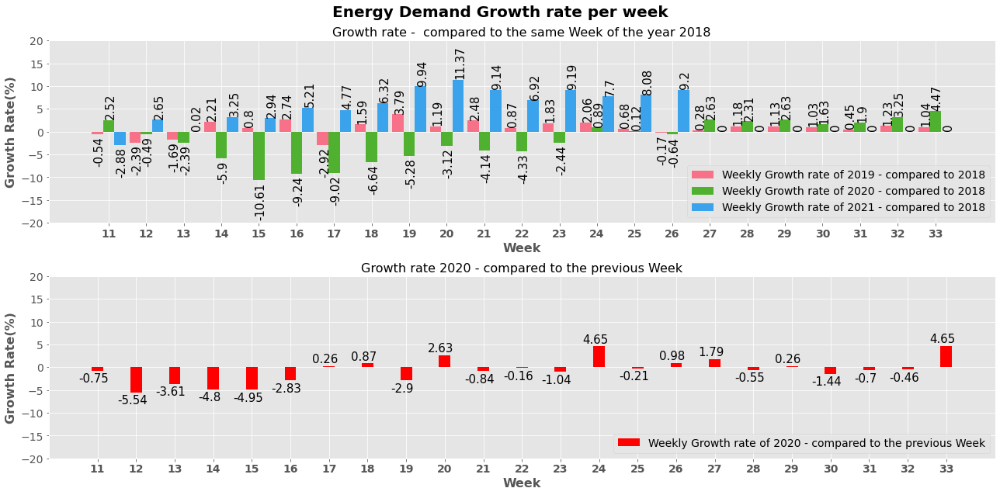

In [137]:
# # weekly Demand growth rate
plt_data.plot_growth_rates( gr1 = gr_weekly_demand,  # Growth rate compared to - 2018 for energy Demand
                            years_to_compare = [2019,2020, 2021],
                            base_year = 2018, 
                            gr2 = gr_w_2020_demand[1:len(gr_w_2020_demand)-1],  # Growth rate compared to the previous week for 2020
                            gr2_y=2020 ,
                            typ = 'Week',
                            nrows=2, 
                            ncols=1,
                            barwidth = 0.3, 
                            title= "Energy Demand Growth rate per week",
                            ha='left',
                            rot=90,
                            xtick_labels = np.arange(11,34) ,
                            figsize=(18, 9),
                            ylim = (-20,20),
                            legend_loc='lower right'
                            )

##### Statistical test

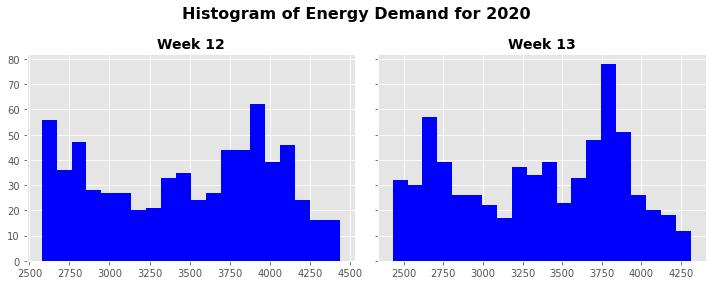

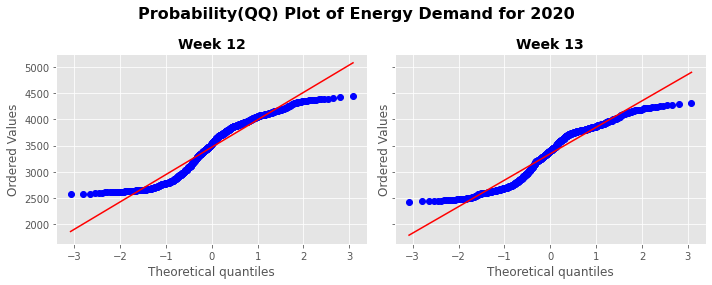

Sample size -Week 12 -2020 : 672
Sample size -Week 13 -2020 : 668
Mann-Whitney U Test
Statistics=191314.500, p-value=1.448107172404693e-06
Different distribution (reject H0)


In [174]:
demand_week12_2020 = demand_2020[demand_2020.index.isocalendar().week == 12]
demand_week13_2020 = demand_2020[demand_2020.index.isocalendar().week == 13]

demand4 = {
    'Week 12': demand_week12_2020.dropna(),
    'Week 13': demand_week13_2020.dropna()
}

# ~------------------------------Normality assumtion----------------------
# Plot Histogram of yearly demand
plt_data.plot_normality_check(  data = demand4,
                                figsize = (10,4) ,  
                                title = "Histogram of Energy Demand for 2020", 
                                # ylim = (0,300),
                                plot_type='H'  # histogram
                            )

# QQ-plot of yearly demand
plt_data.plot_normality_check(  data = demand4,  
                                figsize = (10,4) ,
                                title = "Probability(QQ) Plot of Energy Demand for 2020", 
                                # ylim = (1000,5600),
                                plot_type='Q' # QQ plot
                            )

print('Sample size -Week 12 -2020 : %s'  %(len(demand_week12_2020.dropna())))
print('Sample size -Week 13 -2020 : %s'  %(len(demand_week13_2020.dropna())))    


compare_2_samples(
    data1= demand_week12_2020.dropna(), 
    data2= demand_week13_2020.dropna(), 
    alpha= 0.05, 
    dist = 'Non-Normal'
)

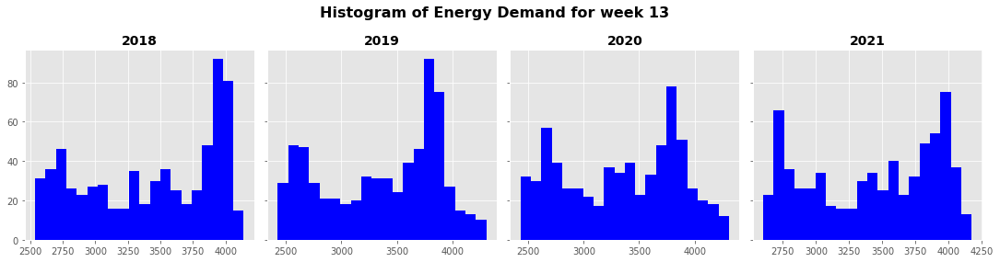

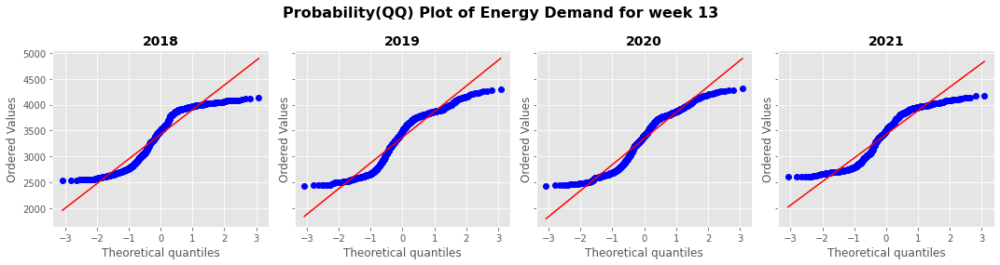

Sample size -week 13 -2018 : 672
Sample size -week 13 -2019 : 668
Sample size -week 13 -2020 : 668
Sample size -week 13 -2021 : 672


In [175]:
demand_week13_2018 = demand_2018[demand_2018.index.isocalendar().week == 13]
demand_week13_2019 = demand_2019[demand_2019.index.isocalendar().week == 13]
demand_week13_2020 = demand_2020[demand_2020.index.isocalendar().week == 13]
demand_week13_2021 = demand_2021[demand_2021.index.isocalendar().week == 13]

demand3 = {
    2018 : demand_week13_2018.dropna(),
    2019 : demand_week13_2019.dropna(),
    2020 : demand_week13_2020.dropna(),
    2021 : demand_week13_2021.dropna()
}

# ~------------------------------Normality assumtion----------------------
# Plot Histogram of yearly demand
plt_data.plot_normality_check(  data = demand3,  
                                figsize = (15,4) ,
                                title = "Histogram of Energy Demand for week 13", 
                                # ylim = (0,300),
                                plot_type='H'  # histogram
                            )

# QQ-plot of yearly demand
plt_data.plot_normality_check(  data = demand3, 
                                figsize = (15,4) , 
                                title = "Probability(QQ) Plot of Energy Demand for week 13", 
                                # ylim = (1000,5600),
                                plot_type='Q' # QQ plot
                            )

print('Sample size -week 13 -2018 : %s'  %(len(demand_week13_2018.dropna()))) 
print('Sample size -week 13 -2019 : %s'  %(len(demand_week13_2019.dropna()))) 
print('Sample size -week 13 -2020 : %s'  %(len(demand_week13_2020.dropna()))) 
print('Sample size -week 13 -2021 : %s'  %(len(demand_week13_2021.dropna())))  

In [168]:
print('Comaparison of energy demand for the week 13(lockdown started)')
print('---------------------------------------------------------')
print( '\nYears in comparision : 2018,2019,2020,2021')
print("Kruskal-Wallis H Test") 
stat, p = kruskal(demand_week13_2018.dropna(), demand_week13_2019.dropna(), demand_week13_2020.dropna(), demand_week13_2021.dropna())
print('Statistics=%.3f, p-value=%s' % (stat, p))

# interpret
alpha =0.05
if p > alpha:
	print('Same distribution (fail to reject H0)')
else:
	print('Different distribution (reject H0)')


for k , v in  demand3.items():

    if k == 2020:
        continue

    print("\nComparision between years %s and %s" %(k, 2020))
    compare_2_samples( 
        v.dropna(),
        demand_week13_2020.dropna(), 
        alpha= 0.05, 
        dist='Non-Norm'
    )

print('Comaparison of energy demand for the week 14')

Comaparison of energy demand for the week 13(lockdown started)
---------------------------------------------------------

Years in comparision : 2018,2019,2020,2021
Kruskal-Wallis H Test
Statistics=22.745, p-value=4.5636541554545215e-05
Different distribution (reject H0)

Comparision between years 2018 and 2020
Mann-Whitney U Test
Statistics=198323.500, p-value=0.00011281376751403829
Different distribution (reject H0)

Comparision between years 2019 and 2020
Mann-Whitney U Test
Statistics=217172.000, p-value=0.1997926477384016
Same distribution (fail to reject H0)

Comparision between years 2021 and 2020
Mann-Whitney U Test
Statistics=199209.500, p-value=0.00018307422031031662
Different distribution (reject H0)
Comaparison of energy demand for the week 14


#### Daily data- Ireland

In [138]:
# Different stages of lockdown
LOCKDOWN_STAGES_D = {   STAGE1 : 87,  # Start of lockdown
                        STAGE2 : 139, # Phase 1 reopning
                        STAGE3 : 160, # Phase 2 reopning
                        STAGE4 : 181, # Phase 3 reopning
                        STAGE5 : 202, # Phase 4 reopning
                        STAGE6 : 223, # Phase 5 reopning
                        STAGE7 : 295, # 2nd Lockdown
                        STAGE8 : 336, # Reopning
                        STAGE9 : 361  # 3rd Lockdon
                        }

##### Daily moving Avg. Demand -  year wise

In [140]:
# step 1:- resample avg for 1day 
# step 2:- each day moving  avg
ra_ire_1d = ire.set_index('datetime').resample('1D').mean().rolling(window=28).mean()

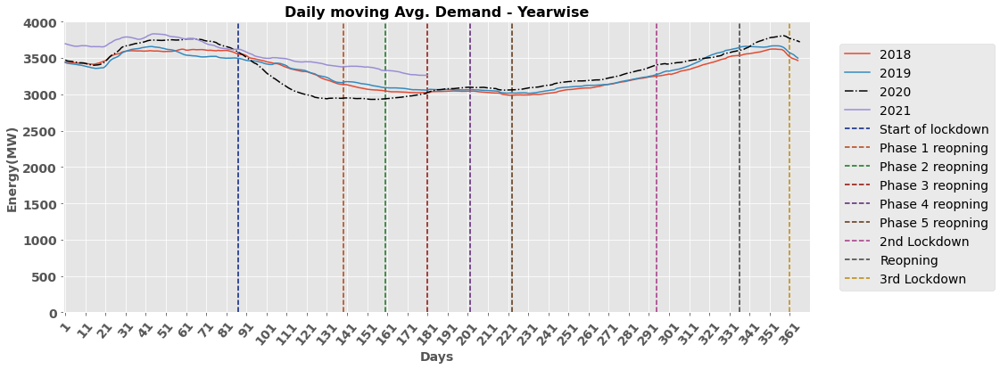

In [144]:
# moving avarage daily demand plot - year wise
plt_data.create_line_plot(  df=ra_ire_1d,
                            selected_years=[2018, 2019, 2020, 2021],
                            v_loc=LOCKDOWN_STAGES_D,
                            typ = DEMAND,
                            title='Daily moving Avg. Demand - Yearwise',
                            ylabel='Energy(MW)',
                            xlabel='Days',
                            xticks=range(1, 371, 10) ,
                            figsize=(15,6),
                            xlim=(0,371), 
                            ylim=(0,4000),
                            xtick_rot=50
                            )

##### Moving Avg. Wind generation - Daily

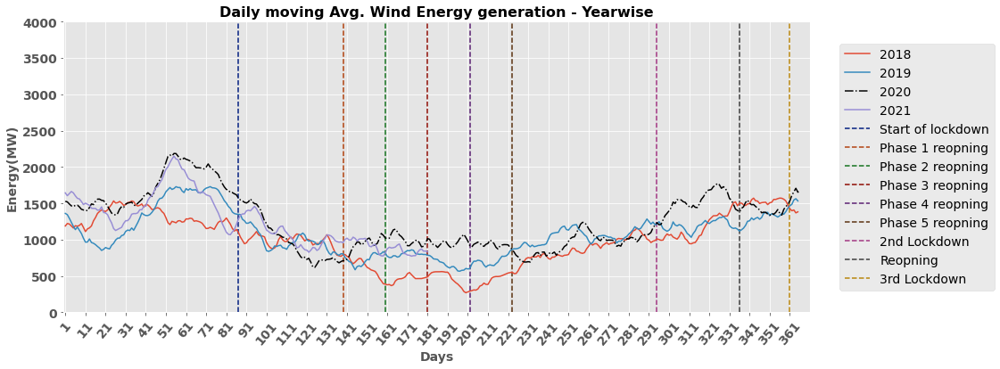

In [145]:
# moving avarage daily demand plot - year wise
plt_data.create_line_plot(  df=ra_ire_1d,
                            selected_years=[2018, 2019, 2020, 2021],
                            v_loc=LOCKDOWN_STAGES_D,
                            typ = WIND_G,
                            title='Daily moving Avg. Wind Energy generation - Yearwise',
                            ylabel='Energy(MW)',
                            xlabel='Days',
                            xticks=range(1, 371, 10) ,
                            figsize=(15,6),
                            xlim=(0,371),
                            ylim=(0,4000),
                            xtick_rot=50 
                            )